In [1]:
import pandas as pd 
import numpy as np 
from scipy.stats import zscore
import matplotlib.pyplot as plt
import seaborn as sns
from windrose import WindroseAxes
import plotly.express as px

In [2]:
data_frame = pd.read_csv("../data/sierraleone-bumbuna.csv")

In [3]:
data_frame.head()

,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
0,2021-10-30 00:01,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.1,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
1,2021-10-30 00:02,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
2,2021-10-30 00:03,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN
3,2021-10-30 00:04,-0.7,0.0,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.1,22.3,22.6,NaN
4,2021-10-30 00:05,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6,NaN


In [4]:
data_frame.describe()

,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
count,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,0.0
mean,201.957515,116.376337,113.720571,206.643095,198.114691,26.319394,79.448857,1.146113,1.691606,0.363823,133.044668,7.172220,999.876469,0.000967,0.004806,32.504263,32.593091,NaN
std,298.495150,218.652659,158.946032,300.896893,288.889073,4.398605,20.520775,1.239248,1.617053,0.295000,114.284792,7.535093,2.104419,0.031074,0.047556,12.434899,12.009161,NaN
min,-19.500000,-7.800000,-17.900000,0.000000,0.000000,12.300000,9.900000,0.000000,0.000000,0.000000,0.000000,0.000000,993.000000,0.000000,0.000000,10.700000,11.100000,NaN
25%,-2.800000,-0.300000,-3.800000,0.000000,0.000000,23.100000,68.700000,0.000000,0.000000,0.000000,0.000000,0.000000,999.000000,0.000000,0.000000,23.500000,23.800000,NaN
50%,0.300000,-0.100000,-0.100000,3.600000,3.400000,25.300000,85.400000,0.800000,1.600000,0.400000,161.500000,6.200000,1000.000000,0.000000,0.000000,26.600000,26.900000,NaN
75%,362.400000,107.000000,224.700000,359.500000,345.400000,29.400000,96.700000,2.000000,2.600000,0.600000,234.100000,12.000000,1001.000000,0.000000,0.000000,40.900000,41.300000,NaN
max,1499.000000,946.000000,892.000000,1507.000000,1473.000000,39.900000,100.000000,19.200000,23.900000,4.100000,360.000000,98.400000,1006.000000,1.000000,2.400000,72.800000,70.400000,NaN


In [5]:
data_frame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 525600 entries, 0 to 525599
Data columns (total 19 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Timestamp      525600 non-null  object 
 1   GHI            525600 non-null  float64
 2   DNI            525600 non-null  float64
 3   DHI            525600 non-null  float64
 4   ModA           525600 non-null  float64
 5   ModB           525600 non-null  float64
 6   Tamb           525600 non-null  float64
 7   RH             525600 non-null  float64
 8   WS             525600 non-null  float64
 9   WSgust         525600 non-null  float64
 10  WSstdev        525600 non-null  float64
 11  WD             525600 non-null  float64
 12  WDstdev        525600 non-null  float64
 13  BP             525600 non-null  int64  
 14  Cleaning       525600 non-null  int64  
 15  Precipitation  525600 non-null  float64
 16  TModA          525600 non-null  float64
 17  TModB          525600 non-nul

In [6]:
data_frame = data_frame.drop(["Comments"], axis=1)

In [7]:
data_frame.isnull().sum()

Timestamp        0
GHI              0
DNI              0
DHI              0
ModA             0
ModB             0
Tamb             0
RH               0
WS               0
WSgust           0
WSstdev          0
WD               0
WDstdev          0
BP               0
Cleaning         0
Precipitation    0
TModA            0
TModB            0
dtype: int64

In [8]:
data_frame=data_frame.dropna()
data_frame.isnull().sum()

Timestamp        0
GHI              0
DNI              0
DHI              0
ModA             0
ModB             0
Tamb             0
RH               0
WS               0
WSgust           0
WSstdev          0
WD               0
WDstdev          0
BP               0
Cleaning         0
Precipitation    0
TModA            0
TModB            0
dtype: int64

In [9]:
data_frame.head()

,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB
0,2021-10-30 00:01,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.1,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6
1,2021-10-30 00:02,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6
2,2021-10-30 00:03,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.2,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6
3,2021-10-30 00:04,-0.7,0.0,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.1,22.3,22.6
4,2021-10-30 00:05,-0.7,-0.1,-0.8,0.0,0.0,21.9,99.3,0.0,0.0,0.0,0.0,0.0,1002,0,0.0,22.3,22.6


In [10]:
cols = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust']

In [11]:
z_scores = zscore(data_frame[cols])
z_df = pd.DataFrame(z_scores, columns=cols)

outlier_mask = (z_df.abs() > 3).any(axis=1)

outliers = data_frame[outlier_mask]
print("Outliers found:", len(outliers))

data_frame = data_frame[~outlier_mask]
data_frame.to_csv('../cleaned data/cleaned-sierraleone-bumbuna.csv')


Outliers found: 16292


GHI column info:
count    509308.000000
mean        185.000024
std         279.019460
min         -15.900000
25%          -3.300000
50%          -0.400000
75%         331.300000
max        1097.000000
Name: GHI, dtype: float64

Missing values: 0
Unique values: [-7.000e-01 -6.000e-01 -8.000e-01 ...  1.089e+03  1.097e+03  1.081e+03]


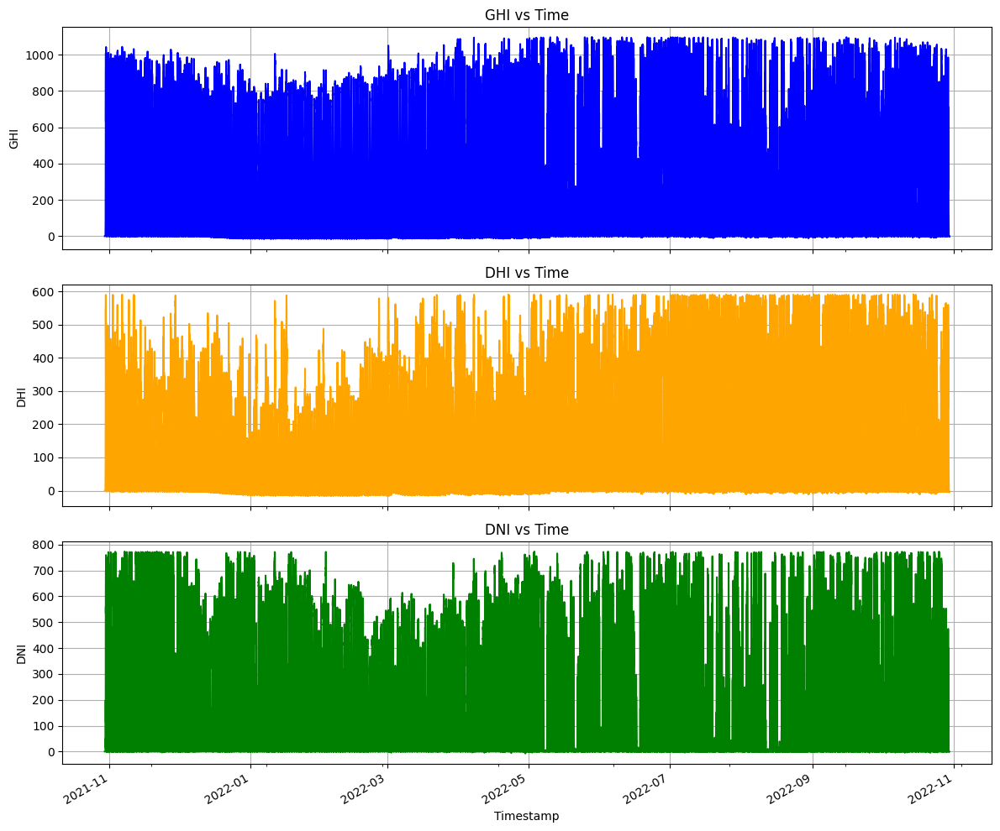

In [12]:
import pandas as pd
import matplotlib.pyplot as plt

data_frame.head()
data_frame.columns = data_frame.columns.str.strip()  # Strip whitespace from all column names

# Check for nulls and unique values
print("GHI column info:")
print(data_frame['GHI'].describe())
print("\nMissing values:", data_frame['GHI'].isnull().sum())
print("Unique values:", data_frame['GHI'].unique())

# Parse Timestamp and set as index
data_frame['Timestamp'] = pd.to_datetime(data_frame['Timestamp'])
data_frame.set_index('Timestamp', inplace=True)

# Plot each column separately
fig, axes = plt.subplots(3, 1, figsize=(12, 10), sharex=True)

data_frame['GHI'].plot(ax=axes[0], title='GHI vs Time', color='blue')
axes[0].set_ylabel('GHI')
axes[0].grid(True)

data_frame['DHI'].plot(ax=axes[1], title='DHI vs Time', color='orange')
axes[1].set_ylabel('DHI')
axes[1].grid(True)

data_frame['DNI'].plot(ax=axes[2], title='DNI vs Time', color='green')
axes[2].set_ylabel('DNI')
axes[2].set_xlabel('Timestamp')
axes[2].grid(True)

plt.tight_layout()
plt.show()


In [13]:
if 'CleanFlag' in data_frame.columns:
    cleaning_avg = data_frame.groupby('CleanFlag')[['ModA', 'ModB']].mean()
    cleaning_avg.plot(kind='bar', title='Cleaning Impact on ModA & ModB')
    plt.ylabel('Average Irradiance')
    plt.grid(True)
    plt.show()

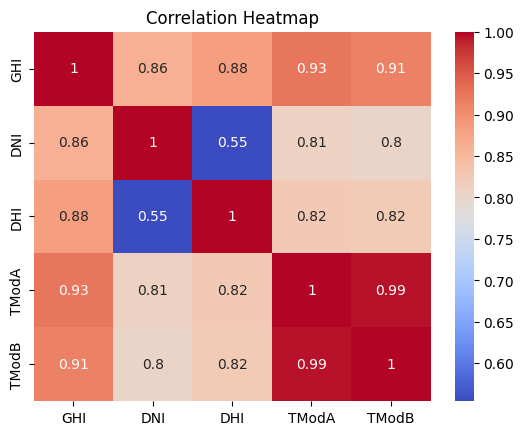

In [14]:
corr_cols = ['GHI', 'DNI', 'DHI', 'TModA', 'TModB']
heat_data = data_frame[[col for col in corr_cols if col in data_frame.columns]]
sns.heatmap(heat_data.corr(), annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()

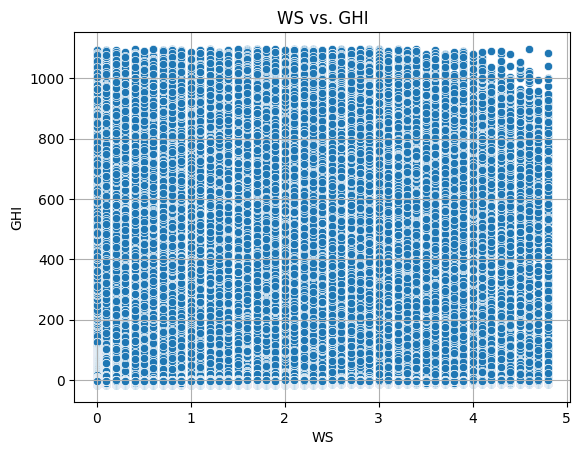

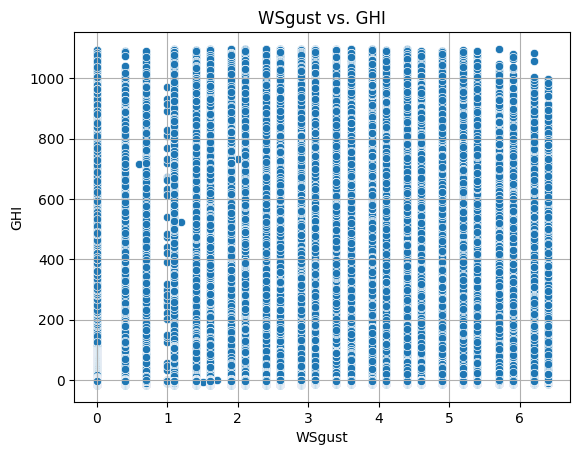

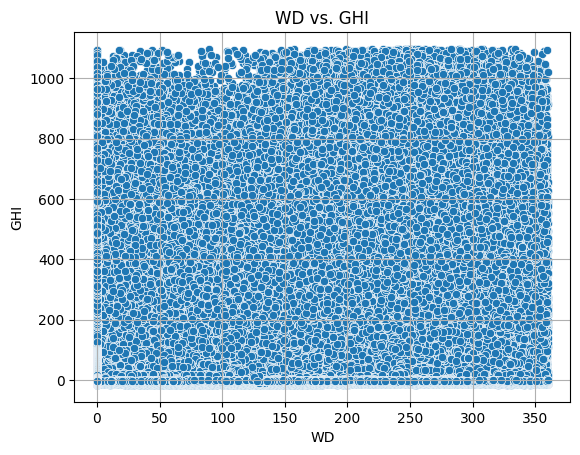

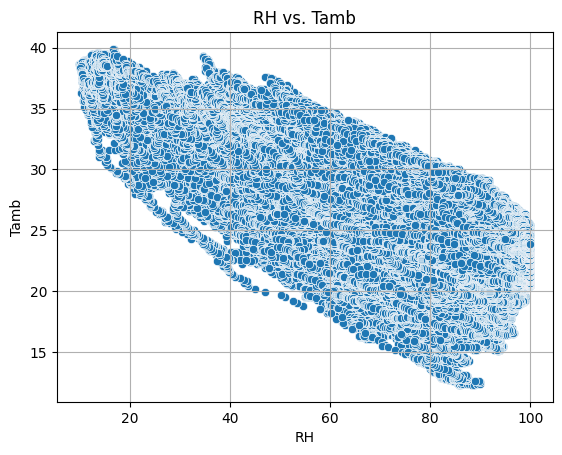

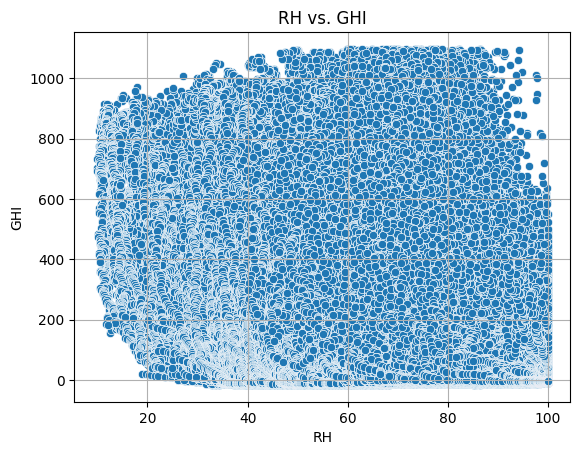

In [15]:
#  Scatter Plots
scatter_pairs = [('WS', 'GHI'), ('WSgust', 'GHI'), ('WD', 'GHI'), ('RH', 'Tamb'), ('RH', 'GHI')]

for x, y in scatter_pairs:
    if x in data_frame.columns and y in data_frame.columns:
        sns.scatterplot(data=data_frame, x=x, y=y)
        plt.title(f'{x} vs. {y}')
        plt.grid(True)
        plt.show()


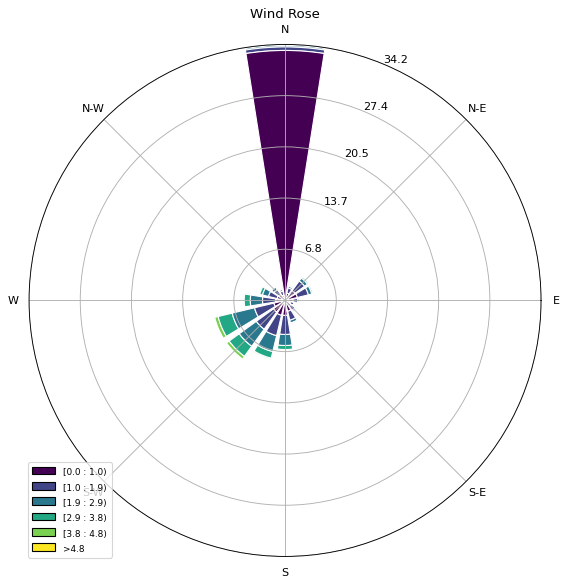

In [16]:
# Wind Rose
if 'WS' in data_frame.columns and 'WD' in data_frame.columns:
    ax = WindroseAxes.from_ax()
    ax.bar(data_frame['WD'], data_frame['WS'], normed=True, opening=0.8, edgecolor='white')
    ax.set_legend()
    plt.title('Wind Rose')
    plt.show()

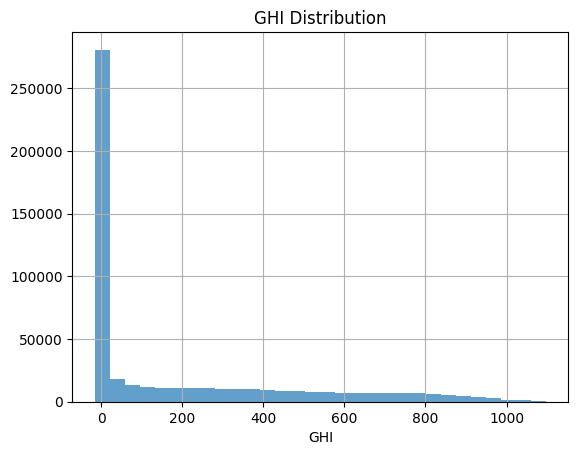

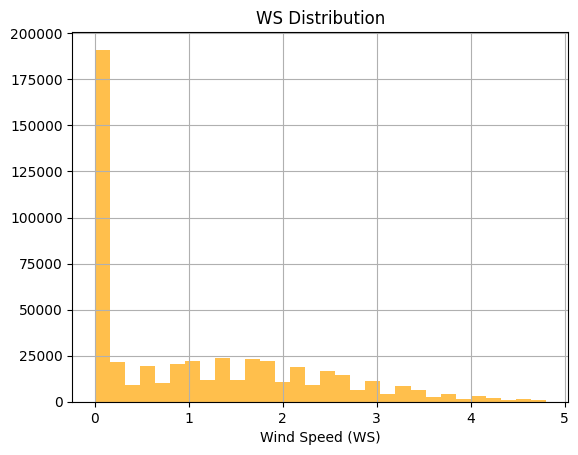

In [17]:
# Histograms

data_frame['GHI'].hist(bins=30, alpha=0.7)
plt.title("GHI Distribution")
plt.xlabel("GHI")
plt.grid(True)
plt.show()

if 'WS' in data_frame.columns:
    data_frame['WS'].hist(bins=30, alpha=0.7, color='orange')
    plt.title("WS Distribution")
    plt.xlabel("Wind Speed (WS)")
    plt.grid(True)
    plt.show()

In [18]:
# Bubble Chart
size_col = 'RH' if 'RH' in data_frame.columns else 'BP' if 'BP' in data_frame.columns else None

if 'GHI' in data_frame.columns and 'Tamb' in data_frame.columns and size_col:
    fig = px.scatter(
        data_frame.reset_index(), x='Tamb', y='GHI',
        size=size_col,
        color=size_col,
        title=f'Bubble Chart: GHI vs. Tamb (Bubble = {size_col})',
        labels={'Tamb': 'Temperature Ambient', 'GHI': 'Global Horizontal Irradiance'}
    )
    fig.show()